In [1]:
import torch, torchvision

import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import detectron2 utilities
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

import matplotlib.pyplot as plt
import numpy as np
import cv2
from google.colab.patches import cv2_imshow

/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.6/site-packages/IPython/utils/traitlets.py:5: UserWarning: IPython.utils.traitlets has moved to a top-level traitlets package.
  warn("IPython.utils.traitlets has moved to a top-level traitlets package.")


# 1. Training Set 읽어오기

In [2]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("deep_fashion", {}, "/home/lab24/tutorials/datasets/deepfashion2_train_100k.json", "/home/lab24/tutorials/datasets/fashion/train_100k/image")

In [3]:
deep_fashion_metadata = MetadataCatalog.get("deep_fashion")
dataset_dicts = DatasetCatalog.get("deep_fashion")

[06/19 21:20:16 d2.data.datasets.coco]: Loading /home/lab24/tutorials/datasets/deepfashion2_train_100k.json takes 26.63 seconds.
[06/19 21:20:16 d2.data.datasets.coco]: Loaded 99999 images in COCO format from /home/lab24/tutorials/datasets/deepfashion2_train_100k.json


# 2. Training Set 확인하기
- BBox 및 Segmentation 좌표 확인

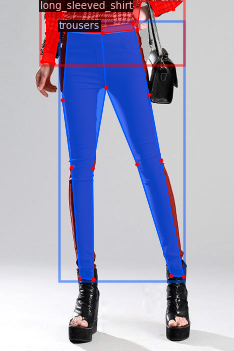

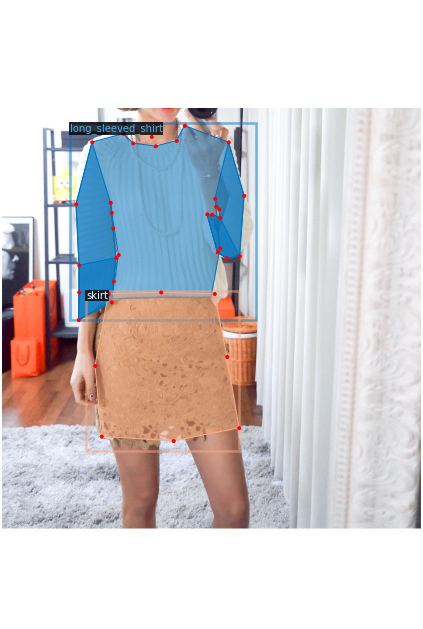

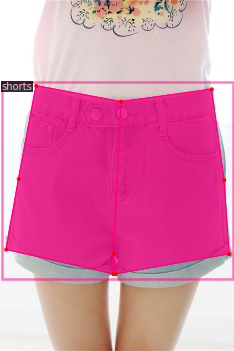

In [5]:
import random

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=deep_fashion_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

In [6]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
import os

cfg = get_cfg()
cfg.merge_from_file("./detectron2_repo/configs/COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml")
cfg.DATASETS.TRAIN = ("deep_fashion",)
cfg.DATASETS.TEST = ("deep_fashion_val",)
cfg.DATALOADER.NUM_WORKERS = 16
# 모델 설정(최초 model.zoo에서 ResNext Pretrained 모델 활용)
cfg.MODEL.WEIGHTS = "/home/lab24/Detectron2/output/final/model_final_0.238_0.0001.200605.pth"  # initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 8
# Learning Rate 설정
cfg.SOLVER.BASE_LR = 0.001
# Iteration 수
cfg.SOLVER.MAX_ITER = 1000
# cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128
# 분류할 의상 총 13가지
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 13
cfg.TEST.EVAL_PERIOD = 20

# 학습 수행
# os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
# trainer = DefaultTrainer(cfg)
# trainer.resume_or_load(resume=False)
# trainer.train()

# 3. Test Set을 통한 Instance Segmentation 결과 확인

In [8]:
import os

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "/home/lab24/Detectron2/output/final/model_final_0.238_0.0001.200605.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set the testing threshold for this model
cfg.DATASETS.TEST = ("deep_fashion_val", )
predictor = DefaultPredictor(cfg)

RuntimeError: CUDA error: out of memory

In [9]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("deep_fashion_val", {}, "/home/lab24/tutorials/datasets/deepfashion2_val_min.json", "/home/lab24/tutorials/datasets/fashion/validation_min/image")

In [10]:
deep_fashion_metadata2 = MetadataCatalog.get("deep_fashion_val")
dataset_dicts2 = DatasetCatalog.get("deep_fashion_val")

[06/19 21:46:19 d2.data.datasets.coco]: Loaded 1999 images in COCO format from /home/lab24/tutorials/datasets/deepfashion2_val_min.json


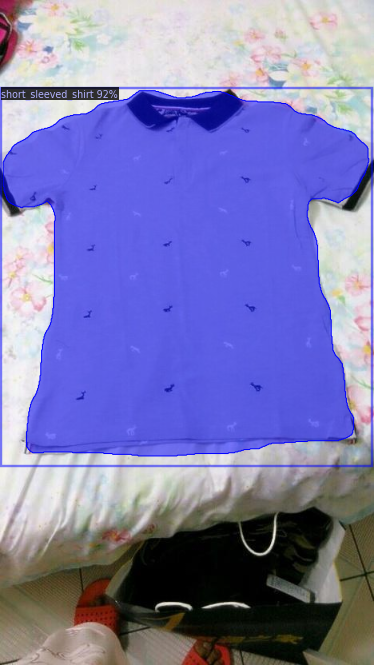

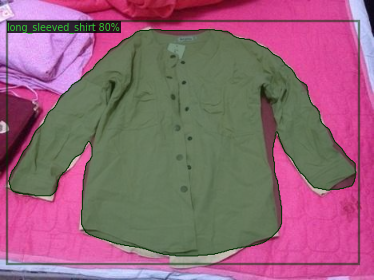

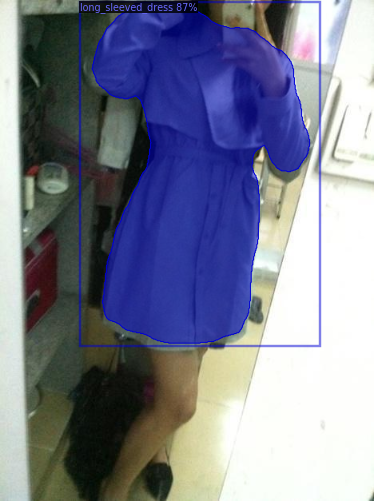

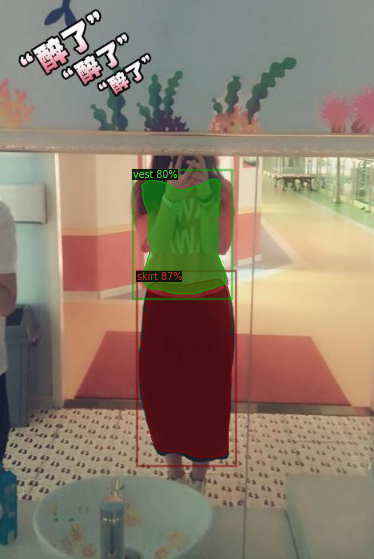

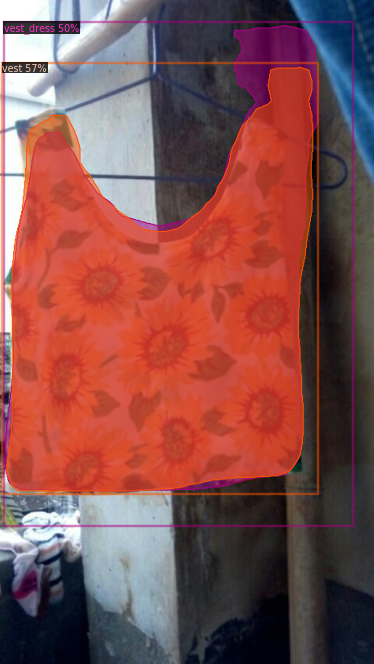

...

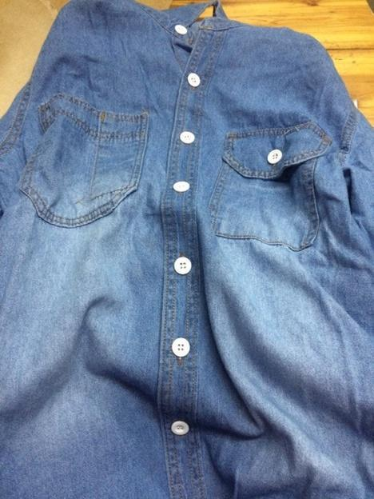

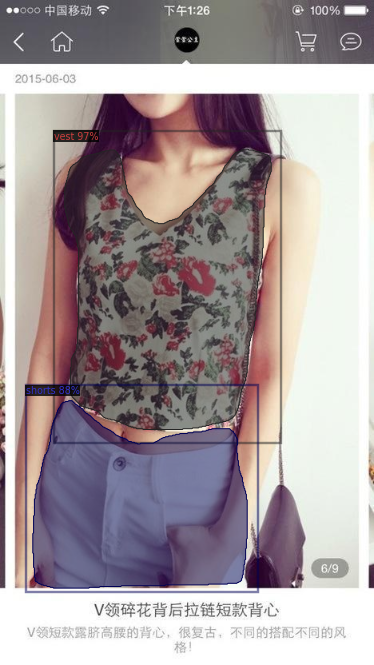

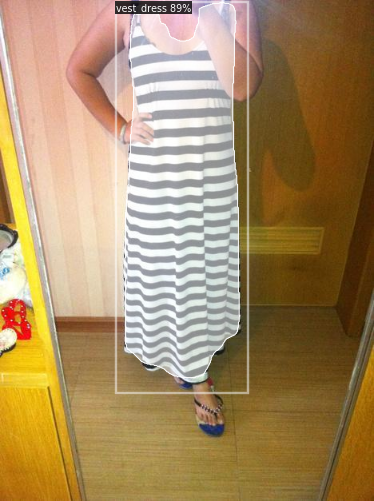

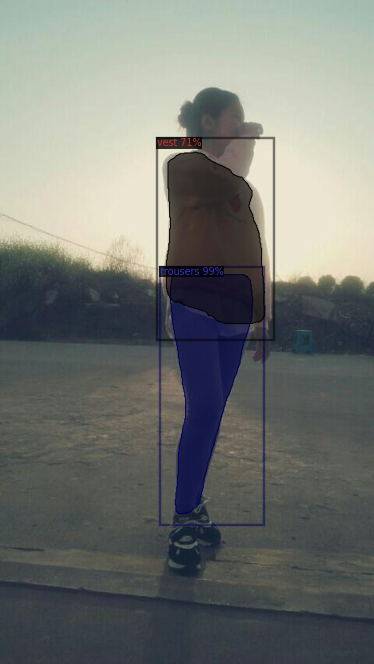

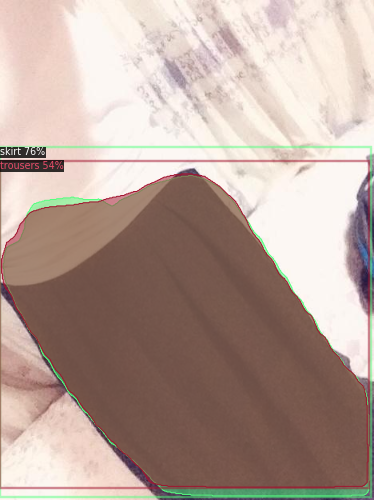

In [11]:
from detectron2.utils.visualizer import ColorMode

for d in random.sample(dataset_dicts2, 100):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=deep_fashion_metadata2, 
                   scale=0.8, 
#                    instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])